# Set Up

## Installs

In [ ]:
pip install numpy accelerate diffusers ftfy bitsandbytes safetensors peft wandb datasets

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 1.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 122.4/122.4 MB 17.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 320.7/320.7 kB 15.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 472.7/472.7 kB 32.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 9.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 10.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 11.0 MB/s eta 0:00:00


In [ ]:
%pip install -qq git+https://github.com/huggingface/diffusers

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [ ]:
!wget -q https://raw.githubusercontent.com/huggingface/diffusers/main/examples/dreambooth/train_dreambooth.py

In [ ]:
# !wget -q https://raw.githubusercontent.com/huggingface/diffusers/main/examples/dreambooth/train_dreambooth_lora_sdxl.py

In [ ]:
# wget preputils undso, was noch nötig ist aus eigenem repo?

## Imports

In [ ]:
from diffusers import StableDiffusionPipeline, StableDiffusionXLPipeline, DDIMScheduler, DDPMScheduler, DPMSolverMultistepScheduler
from diffusers.utils import make_image_grid
from google.colab import userdata, drive, files
from string import whitespace
from collections import OrderedDict
from PIL import Image
from transformers import BlipProcessor, BlipForConditionalGeneration
from datasets import load_dataset

import itertools
import matplotlib.pyplot as plt
import numpy as np
import torch
import os
import shutil
import tensorflow as tf
import datetime
import datasets
import json
import requests
import wandb
import sys
import prep_utils

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

In [ ]:
# del sys.modules['prep_utils']

## Environment config

In [ ]:
!accelerate config default

accelerate configuration saved at /root/.cache/huggingface/accelerate/default_config.yaml


In [ ]:
!wandb login

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit: 
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


## Colab Secrets

In [ ]:
os.environ['HF_TOKEN']= userdata.get('Huggingface')

## Prep

In [ ]:
drive.mount('/content/drive') # access google drive

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
shutil.copytree('/content/drive/MyDrive/results/woman_sd15_120', '/content/woman')


'/content/woman'

In [ ]:
os.listdir("/content/man")

[]

In [ ]:
shutil.copytree('/content/drive/MyDrive/results/man_sd15_70', '/content/man')


'/content/man'

In [ ]:
# shutil.copytree('/content/woman', '/content/drive/MyDrive/results/woman_sd15_120')


'/content/drive/MyDrive/results/woman_sd15_120'

In [ ]:
# shutil.copytree('/content/drive/MyDrive/results/man_sdxl', '/content/man')


'/content/man'

In [ ]:
# shutil.copytree('/content/drive/MyDrive/results/woman_sdxl', '/content/woman')

'/content/woman'

### Setup Single Training Run

In [ ]:
base_dir = '/content/drive/MyDrive/training_images' # path to all training images in google drive
train_directory = '/content/train_images' # path to move the training images to
results_dir = '/content/drive/My Drive/results' # path to result models/embeddings
subfolders = ['textinv', 'dbooth', 'dlora', 'lora'] # subfolders for creating the folder structure

# adjust the parameters below depending on the training process
training_method = 'dbooth' # training method in this notebook
training_model = 'SDv1.5' # model version in this notebook
training_subject = 'hannah' # subject reference to train on

prep_utils.create_folder_structure(results_dir, subfolders)

prep_utils.setup_training_environment(train_directory, results_dir, training_model, training_method, training_subject)


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Root directory already exists: /content/drive/My Drive/results
Subfolder already exists: /content/drive/My Drive/results/textinv
Sub-subfolder already exists: /content/drive/My Drive/results/textinv/SDXL
Sub-subfolder already exists: /content/drive/My Drive/results/textinv/SDv1.5
Sub-subfolder already exists: /content/drive/My Drive/results/textinv/flux
Subfolder already exists: /content/drive/My Drive/results/dbooth
Sub-subfolder already exists: /content/drive/My Drive/results/dbooth/SDXL
Sub-subfolder already exists: /content/drive/My Drive/results/dbooth/SDv1.5
Sub-subfolder already exists: /content/drive/My Drive/results/dbooth/flux
Subfolder already exists: /content/drive/My Drive/results/dlora
Sub-subfolder already exists: /content/drive/My Drive/results/dlora/SDXL
Sub-subfolder already exists: /content/drive/My Drive/results/dlora/SDv1.5
Sub-subfolder 

In [ ]:
images = prep_utils.load_images(base_dir, training_subject)

In [ ]:
prep_utils.move_images(training_subject, images, train_directory)

Saved /content/train_images/hannah_1.jpg
Saved /content/train_images/hannah_2.jpg
Saved /content/train_images/hannah_3.jpg
Saved /content/train_images/hannah_4.jpg
Saved /content/train_images/hannah_5.jpg
Saved /content/train_images/hannah_6.jpg
Saved /content/train_images/hannah_7.jpg
Saved /content/train_images/hannah_8.jpg
Saved /content/train_images/hannah_9.jpg
Saved /content/train_images/hannah_10.jpg


In [ ]:
# prep_utils.empty_directory(train_directory) # removes images and captions from train_directory to prepare for training the next subject


### Setup Training Loop

In [ ]:
base_dir = '/content/drive/MyDrive/training_images' # path to all training images in google drive
train_directory = '/content/train_images' # path to move the training images to
results_dir = '/content/drive/My Drive/results' # path to result models/embeddings
subfolders = ['textinv', 'dbooth', 'dlora', 'lora'] # subfolders for creating the folder structure
# subject_list = ['hannah','timh', 'celine', 'marco', 'jannik', 'christoph', 'patrick','timk', 'leander', 'nils'] # only needed for complete training loop,
subject_list = ['patrick'] # only needed for complete training loop,

# subject_list = ['hannah', 'timh', 'celine', 'timk', 'leander'] #
# subject_list = ['patrick','timk', 'leander', 'nils'] # only needed for complete training loop,
# subject_list = ['christoph', 'marco', 'nils']
# subject_list =['jannik']

# adjust the parameters below depending on the training process
training_method = 'dbooth' # training method in this notebook
training_model = 'SDv1.5' # model version in this notebook

prep_utils.create_folder_structure(results_dir, subfolders)


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Root directory already exists: /content/drive/My Drive/results
Subfolder already exists: /content/drive/My Drive/results/textinv
Sub-subfolder already exists: /content/drive/My Drive/results/textinv/SDXL
Sub-subfolder already exists: /content/drive/My Drive/results/textinv/SDv1.5
Sub-subfolder already exists: /content/drive/My Drive/results/textinv/flux
Subfolder already exists: /content/drive/My Drive/results/dbooth
Sub-subfolder already exists: /content/drive/My Drive/results/dbooth/SDXL
Sub-subfolder already exists: /content/drive/My Drive/results/dbooth/SDv1.5
Sub-subfolder already exists: /content/drive/My Drive/results/dbooth/flux
Subfolder already exists: /content/drive/My Drive/results/dlora
Sub-subfolder already exists: /content/drive/My Drive/results/dlora/SDXL
Sub-subfolder already exists: /content/drive/My Drive/results/dlora/SDv1.5
Sub-subfolder 

In [ ]:
# prep_utils.empty_directory(train_directory) # removes images and captions from train_directory to prepare for training the next subject


# Upload Training Images

In [ ]:
prep_utils.alt_upload_images(train_directory)

Uploading instance images for `photo of a C00_001 man`


Saving 20160725_122032-min.jpg to 20160725_122032-min.jpg
Saving 20160729_163510-min.jpg to 20160729_163510-min.jpg
Saving 20160811_102314_HDR-min.jpg to 20160811_102314_HDR-min.jpg
Saving 20160811_142619-min.jpg to 20160811_142619-min.jpg
Saving 20160813_095807-min.jpg to 20160813_095807-min.jpg
Saving 20170812_133843_HDR-min.jpg to 20170812_133843_HDR-min.jpg


# Trainings

## Training Dreambooth (SD1.5)

In [ ]:
!echo $TRAIN_DIR
!echo $OUTPUT_DIR
!echo $MODEL_NAME
!echo $VALID_PROMPT
!echo $RESOLUTION
!echo $CLASS_DIR
!echo $CLASS_PROMPT
!echo $INSTANCE_PROMPT

/content/train_images
/content/drive/My Drive/results/dbooth/SDv1.5/hannah
benjamin-paine/stable-diffusion-v1-5
business headshot of a ohwx woman
512
/content/woman
photo of a woman
photo of a ohwx woman


In [ ]:
!mkdir "/content/drive/MyDrive/results/archive/sd15_dbooth_hannah_5"

In [ ]:
# Check if the MODEL_NAME is set correctly
if os.environ.get('MODEL_NAME') == 'benjamin-paine/stable-diffusion-v1-5':
    # Define the parameters for the training script
    train_params = {
        "pretrained_model_name_or_path": os.environ.get('MODEL_NAME'),
        "output_dir": '/content/drive/MyDrive/results/archive/sd15_dbooth_hannah_5',
        "dataset_name": os.environ.get('TRAIN_DIR'),
        "resolution": os.environ.get('RESOLUTION'),
        "instance_prompt":os.environ.get('INSTANCE_PROMPT'),
        "class_data_dir":os.environ.get('CLASS_DIR'),
        "class_prompt":os.environ.get('CLASS_PROMPT'),
        "num_class_images":20,
        "sample_batch_size":4,
        "with_prior_preservation":True,
        "prior_loss_weight": 0.1,
        "use_8bit_adam": True,
        "train_batch_size": 4,
        "mixed_precision": "fp16",
        "max_train_steps": 3600,
        "num_train_epochs": 300,
        "checkpointing_steps": 100,
        "learning_rate": 1e-05,
        "lr_scheduler": "constant",
        "lr_warmup_steps": 0,
        "validation_steps":50,
        "validation_prompt": os.environ.get('VALID_PROMPT'),
        "report_to": "wandb",
        "seed": 42,
        "gradient_accumulation_steps": 1
    }

    # Save the parameters to a text file
    params_file = os.path.join(os.environ.get('OUTPUT_DIR'), "training_params.txt")
    with open(params_file, "w") as f:
        for key, value in train_params.items():
            f.write(f"{key}: {value}\n")

    # Construct the command to run the training script
    !accelerate launch train_dreambooth.py \
        --pretrained_model_name_or_path="{train_params['pretrained_model_name_or_path']}"  \
        --output_dir='/content/drive/MyDrive/results/archive/sd15_dbooth_hannah_5' \
        --instance_data_dir="{train_params['dataset_name']}" \
        --resolution={train_params['resolution']} \
        --instance_prompt="{train_params['instance_prompt']}" \
        --class_data_dir="{train_params['class_data_dir']}" \
        --class_prompt="{train_params['class_prompt']}" \
        --num_class_images={train_params['num_class_images']} \
        --sample_batch_size={train_params['sample_batch_size']} \
        --resume_from_checkpoint="latest" \
        --use_8bit_adam \
        --mixed_precision="{train_params['mixed_precision']}" \
        --with_prior_preservation --prior_loss_weight={train_params['prior_loss_weight']} \
        --train_batch_size="{train_params['train_batch_size']}" \
        --gradient_accumulation_steps={train_params['gradient_accumulation_steps']} \
        --max_train_steps={train_params['max_train_steps']} \
        --num_train_epochs={train_params['num_train_epochs']} --checkpointing_steps={train_params['checkpointing_steps']} \
        --learning_rate={train_params['learning_rate']} --lr_scheduler="{train_params['lr_scheduler']}" --lr_warmup_steps={train_params['lr_warmup_steps']} \
        --validation_steps={train_params['validation_steps']} --validation_prompt="{train_params['validation_prompt']}" --report_to="{train_params['report_to']}" \
        --seed={train_params['seed']}
else:
    print("Cannot run training script. Environment variable MODEL_NAME is not set correctly. Set MODEL_NAME correctly or use appropriate training script.")

2024-10-22 12:57:26.732999: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-10-22 12:57:26.753814: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-10-22 12:57:26.760101: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-10-22 12:57:27.993936: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
/usr/local/lib/python3.10/dist-packages/accelerate/accelerator.py:494: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.scaler = torch.cuda.amp.GradScaler(*

KeyboardInterrupt: 

In [ ]:
shutil.rmtree('/content/content')

In [ ]:
shutil.copytree('/content/woman', '/content/drive/MyDrive/results/woman_sd1.5')

'/content/drive/MyDrive/results/woman_sd1.5'

In [ ]:
# !accelerate launch train_dreambooth.py \
#   --pretrained_model_name_or_path=$MODEL_NAME  \
#   --output_dir=$OUTPUT_DIR \
#   --instance_data_dir="/content/data/C00_001" \
#   --instance_prompt="photo of a C00_001 man" \
#   --class_data_dir="content/data/man" \
#   --class_prompt="photo of a man" \
#   --with_prior_preservation --prior_loss_weight=1.0 \
#   --seed=1337 \
#   --resolution=512 \
#   --train_batch_size=1 \
#   --train_text_encoder \
#   --mixed_precision="fp16" \
#   --use_8bit_adam \
#   --gradient_accumulation_steps=1 \
#   --learning_rate=2e-6 \
#   --lr_scheduler="constant" \
#   --lr_warmup_steps=0 \
#   --num_class_images=25 \
#   --sample_batch_size=4 \
#   --validation_prompt="business headshot of a C00_001 man" \
#   --num_validation_images=4 \
#   --validation_steps=100 \
#   --max_train_steps=2000


2024-08-26 20:42:54.214133: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-08-26 20:42:54.233355: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-08-26 20:42:54.239102: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-08-26 20:42:55.404336: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
/usr/local/lib/python3.10/dist-packages/accelerate/accelerator.py:482: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.scaler = torch.cuda.amp.GradScaler(*

## Train Loop Dreambooth (SD 1.5)


In [ ]:
for subject in subject_list:
  prep_utils.empty_directory(train_directory) # removes images and captions from train_directory to prepare for training the next subject

  training_subject = subject

  prep_utils.setup_training_environment(train_directory, results_dir, training_model, training_method, training_subject)
  images = prep_utils.load_images(base_dir, training_subject)
  prep_utils.move_images(training_subject, images, train_directory)

  if os.environ.get('MODEL_NAME') == 'benjamin-paine/stable-diffusion-v1-5':
    # Define the parameters for the training script
    train_params = {
        "pretrained_model_name_or_path": os.environ.get('MODEL_NAME'),
        "output_dir": os.environ.get('OUTPUT_DIR'),
        "dataset_name": os.environ.get('TRAIN_DIR'),
        "resolution": os.environ.get('RESOLUTION'),
        "instance_prompt":os.environ.get('INSTANCE_PROMPT'),
        "class_data_dir":os.environ.get('CLASS_DIR'),
        "class_prompt":os.environ.get('CLASS_PROMPT'),
        "num_class_images":70,
        "sample_batch_size":4,
        "with_prior_preservation":True,
        "prior_loss_weight": 0.5,
        "use_8bit_adam": True,
        "train_batch_size": 4,
        "mixed_precision": "fp16",
        "max_train_steps": 1800,
        "num_train_epochs": 300,
        "checkpointing_steps": 100,
        "learning_rate": 5e-06,
        "lr_scheduler": "constant",
        "lr_warmup_steps": 0,
        "validation_steps":100,
        "validation_prompt": os.environ.get('VALID_PROMPT'),
        "report_to": "wandb",
        "seed": 42,
        "gradient_accumulation_steps": 1
    }

    # Save the parameters to a text file
    params_file = os.path.join(os.environ.get('OUTPUT_DIR'), "training_params.txt")
    with open(params_file, "w") as f:
        for key, value in train_params.items():
            f.write(f"{key}: {value}\n")

    # Construct the command to run the training script
    !accelerate launch train_dreambooth.py \
        --pretrained_model_name_or_path="{train_params['pretrained_model_name_or_path']}"  \
        --output_dir="{train_params['output_dir']}" \
        --instance_data_dir="{train_params['dataset_name']}" \
        --resolution={train_params['resolution']} \
        --instance_prompt="{train_params['instance_prompt']}" \
        --class_data_dir="{train_params['class_data_dir']}" \
        --class_prompt="{train_params['class_prompt']}" \
        --num_class_images={train_params['num_class_images']} \
        --sample_batch_size={train_params['sample_batch_size']} \
        --use_8bit_adam \
        --mixed_precision="{train_params['mixed_precision']}" \
        --with_prior_preservation --prior_loss_weight={train_params['prior_loss_weight']} \
        --train_batch_size="{train_params['train_batch_size']}" \
        --gradient_accumulation_steps={train_params['gradient_accumulation_steps']} \
        --max_train_steps={train_params['max_train_steps']} \
        --num_train_epochs={train_params['num_train_epochs']} --checkpointing_steps={train_params['checkpointing_steps']} \
        --learning_rate={train_params['learning_rate']} --lr_scheduler="{train_params['lr_scheduler']}" --lr_warmup_steps={train_params['lr_warmup_steps']} \
        --validation_steps={train_params['validation_steps']} --validation_prompt="{train_params['validation_prompt']}" --report_to="{train_params['report_to']}" \
        --seed={train_params['seed']}
  else:
    print("Cannot run training script. Environment variable MODEL_NAME is not set correctly. Set MODEL_NAME correctly or use appropriate training script.")

  prep_utils.empty_directory(train_directory) # removes images and captions from train_directory to prepare for training the next subject


Directory does not exist: /content/train_images
Saved /content/train_images/patrick_1.jpg
Saved /content/train_images/patrick_2.jpg
Saved /content/train_images/patrick_3.jpg
Saved /content/train_images/patrick_4.jpg
Saved /content/train_images/patrick_5.jpg
Saved /content/train_images/patrick_6.jpg
Saved /content/train_images/patrick_7.jpg
Saved /content/train_images/patrick_8.jpg
Saved /content/train_images/patrick_9.jpg
Saved /content/train_images/patrick_10.jpg
2024-10-27 13:44:52.228866: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-10-27 13:44:52.249484: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-10-27 13:44:52.256337: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to registe

In [ ]:
import shutil

In [ ]:
shutil.copytree('/content/man', '/content/drive/MyDrive/results/man_sd15_70')

'/content/drive/MyDrive/results/man_sd15_70'

# Inference

## Inference (SD 1.5)

In [ ]:
model_path ="dreambooth/C00_001"

In [ ]:
# generator = torch.Generator("cuda").manual_seed(0)

In [ ]:
pipeline = StableDiffusionPipeline.from_pretrained(
    model_path, torch_dtype=torch.float16, variant="fp16", use_safetensors=True, safety_checker= None
).to("cuda")

OSError: Error no file named model_index.json found in directory dreambooth/patrick/checkpoint-1500.

In [ ]:
pipeline.scheduler = DDIMScheduler.from_config(pipeline.scheduler.config)
pipeline.enable_attention_slicing()
# from diffusers import AutoencoderKL
# vae = AutoencoderKL.from_pretrained("stabilityai/sd-vae-ft-mse", torch_dtype=torch.float16).to("cuda")
# pipeline.vae = vae

In [ ]:
prompt = "business headshot of a C00_001 man"
neg_prompt = "(((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquidtongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missingbreasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fusedears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears, old photo, low res, black and white, black and white filter, colorless, (((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquid tongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missing breasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fused ears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears, old photo, low res, black and white, black and white filter, colorless, (((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquid tongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missing breasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fused ears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears, (((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquidtongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missingbreasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fusedears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears,"

  0%|          | 0/20 [00:00<?, ?it/s]

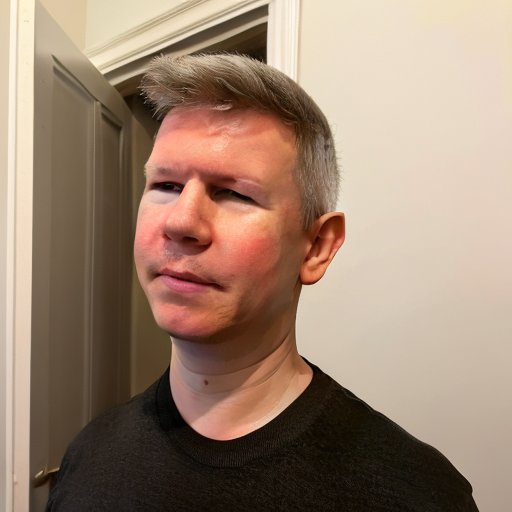

In [ ]:
# image = pipeline(prompt, generator=generator, num_inference_steps=20, guidance_scale=7.5).images[0]
# image

In [ ]:
def get_inputs(batch_size=1):
    generator = [torch.Generator("cuda").manual_seed(i) for i in range(batch_size)]
    prompts = batch_size * [prompt]
    num_inference_steps = 20
    guidance_scale=7.5

    return {"prompt": prompts, "generator": generator, "num_inference_steps": num_inference_steps, "guidance_scale": guidance_scale}

In [ ]:
prompt += "frontal shot, serious look, business clothing, black suit"
prompt += "50mm portrait photography, 8k, high definition, grey background"

  0%|          | 0/20 [00:00<?, ?it/s]

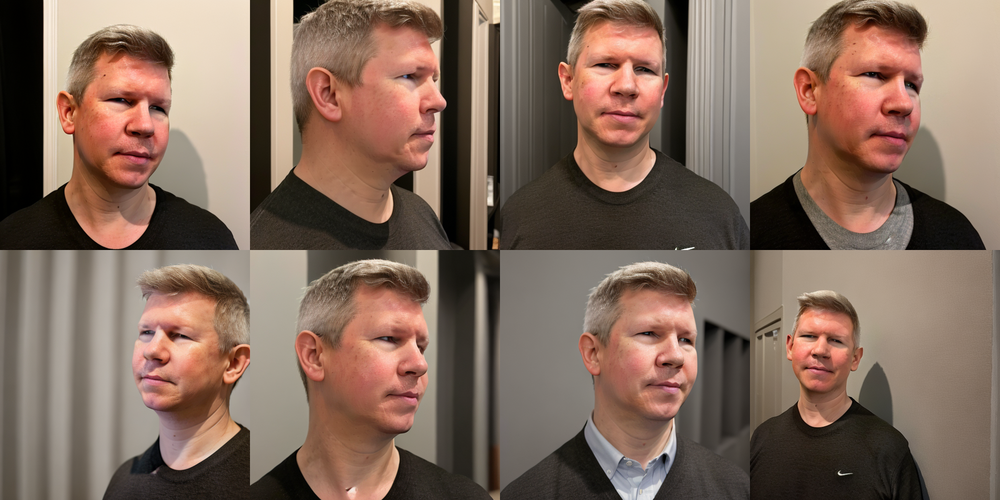

In [ ]:
images = pipeline(**get_inputs(batch_size=8)).images
make_image_grid(images, rows=2, cols=4)

In [ ]:
for i, image in enumerate(images):
    image.save(f"image_{i}.png")

## Inference Grid (SD 1.5)

In [ ]:
from diffusers import DiffusionPipeline, UNet2DConditionModel
from transformers import CLIPTextModel
import torch
# model_path ="dreambooth/patrick"
from diffusers import AutoencoderKL

In [ ]:
# !echo $OUTPUT_DIR

/content/drive/My Drive/results/dbooth/SDv1.5/hannah


In [ ]:
# model_path ="dreambooth/C00_001"

In [ ]:
total_pipes = 3
pipes = []
schedulers = [DDIMScheduler, DDPMScheduler, DPMSolverMultistepScheduler]

In [ ]:
unet = UNet2DConditionModel.from_pretrained("/content/drive/My Drive/results/archive/sd15_dbooth_hannah_8/checkpoint-1500/unet", torch_dtype=torch.float16).to("cuda")
vae = AutoencoderKL.from_pretrained("stabilityai/sd-vae-ft-mse", torch_dtype=torch.float16).to("cuda")


In [ ]:
for i in range(total_pipes):
  pipe = DiffusionPipeline.from_pretrained("benjamin-paine/stable-diffusion-v1-5",
    vae=vae, unet=unet, torch_dtype=torch.float16, use_safetensors=True, safety_checker=None,
  ).to("cuda")
  # pipe = StableDiffusionPipeline.from_pretrained(
  #   model_path, torch_dtype=torch.float16, use_safetensors=True, safety_checker=None,
  # ).to("cuda")
  pipe.scheduler = schedulers[i].from_config(pipe.scheduler.config)

  if pipe.scheduler == DPMSolverMultistepScheduler:
    pipe.scheduler.use_karras_sigmas = True

  # pipe.enable_vae_slicing()
  # pipe.enable_model_cpu_offload()
  # pipe.enable_attention_slicing()

  pipes.append(pipe)

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


In [ ]:
prompt = "business headshot of a ohwx woman"
# neg_prompt = "(((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquidtongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missingbreasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fusedears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears, old photo, low res, black and white, black and white filter, colorless, (((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquid tongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missing breasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fused ears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears, old photo, low res, black and white, black and white filter, colorless, (((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquid tongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missing breasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fused ears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears, (((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquidtongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missingbreasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fusedears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears,"

In [ ]:
inf_start= 20
scale_start=6
max_inf_steps=40 # only goes to -10
max_scale=8 # only goes to -1
inf_step_increase=10
scale_increase=1

In [ ]:
grid_rows=int((max_scale-scale_start))
grid_cols=int((max_inf_steps-inf_start)/inf_step_increase)

In [ ]:
print(grid_rows)
print(grid_cols)

2
2


In [ ]:
def create_parameter_list(prompt):
# def create_parameter_list(prompt, neg_prompt):

    """Creates a list of dictionaries containing the parameters.

    Args:
        prompt: The prompt for the model.
        neg_prompt: The negative prompt for the model.

    Returns:
        A list of dictionaries containing the parameters.
    """

    parameters = []
    for num_inference_steps in range(inf_start, max_inf_steps, inf_step_increase):
        for guidance_scale in range(scale_start, max_scale, scale_increase):
            parameters.append({
                "prompt": prompt,
                # "neg_prompt": neg_prompt,
                "num_inference_steps": num_inference_steps,
                "guidance_scale": guidance_scale
            })
    return parameters

# parameter_list = create_parameter_list(prompt, neg_prompt)
parameter_list = create_parameter_list(prompt)

In [ ]:

def create_image_grid(images, columns, rows, figsize=(10,10),labels_x=None, labels_y=None):
    """
    Creates a grid of images using matplotlib and numpy.

    Args:
        images: A list of image data.
        columns: The number of columns in the grid.
        rows: The number of rows in the grid.
        labels_x: A list of labels for the x-axis (columns).
        labels_y: A list of labels for the y-axis (rows).

    Returns:
        The figure and axes objects.
    """

    fig, axs = plt.subplots(rows, columns, figsize=(10, 10))  # Adjust figure size as needed

    for i in range(rows):
        for j in range(columns):
            index = i * columns + j
            if index < len(images):
                axs[i, j].imshow(images[index])
                axs[i, j].tick_params(axis='both', length=0, width=0)
                axs[i, j].set_xticklabels([])
                axs[i, j].set_yticklabels([])
                axs[i, j].spines['top'].set_visible(False)
                axs[i, j].spines['right'].set_visible(False)
                axs[i, j].spines['bottom'].set_visible(False)
                axs[i, j].spines['left'].set_visible(False)

    # Add column labels
    if labels_x:
        for i in range(columns):
            axs[0, i].set_title(labels_x[i])

    # Add row labels
    if labels_y:
        for i in range(rows):
            axs[i, 0].set_ylabel(labels_y[i])

    return fig, axs

In [ ]:
inference_steps_list = my_list = list(OrderedDict.fromkeys([param["num_inference_steps"] for param in parameter_list]).keys())
guidance_scale_list = my_list = list(OrderedDict.fromkeys([param["guidance_scale"] for param in parameter_list]).keys())
labels_x = [f"Guidance Scale: {step}" for step in guidance_scale_list]
labels_y = [f"Inference Steps: {step}" for step in inference_steps_list]

In [ ]:
%%capture

pipe_outputs = []
for pipe in pipes:
    images = []
    for line in parameter_list:
        # images.extend(pipe(prompt=prompt, neg_prompt=neg_prompt, num_inference_steps=line["num_inference_steps"], guidance_scale=line["guidance_scale"]).images)
        images.extend(pipe(prompt=prompt, num_inference_steps=line["num_inference_steps"], guidance_scale=line["guidance_scale"]).images)

    pipe_outputs.append(images)

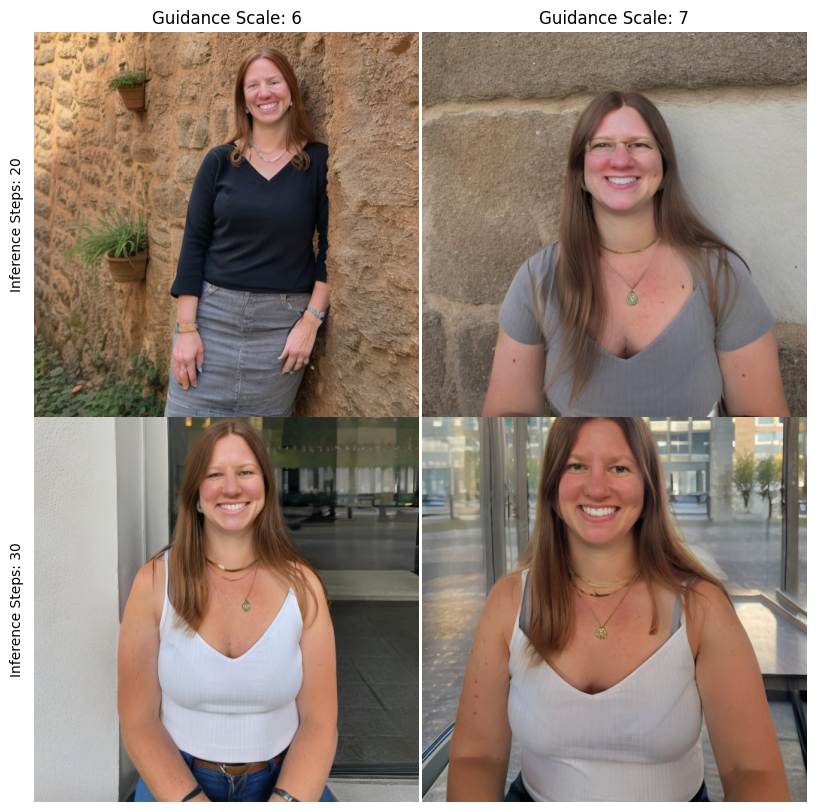

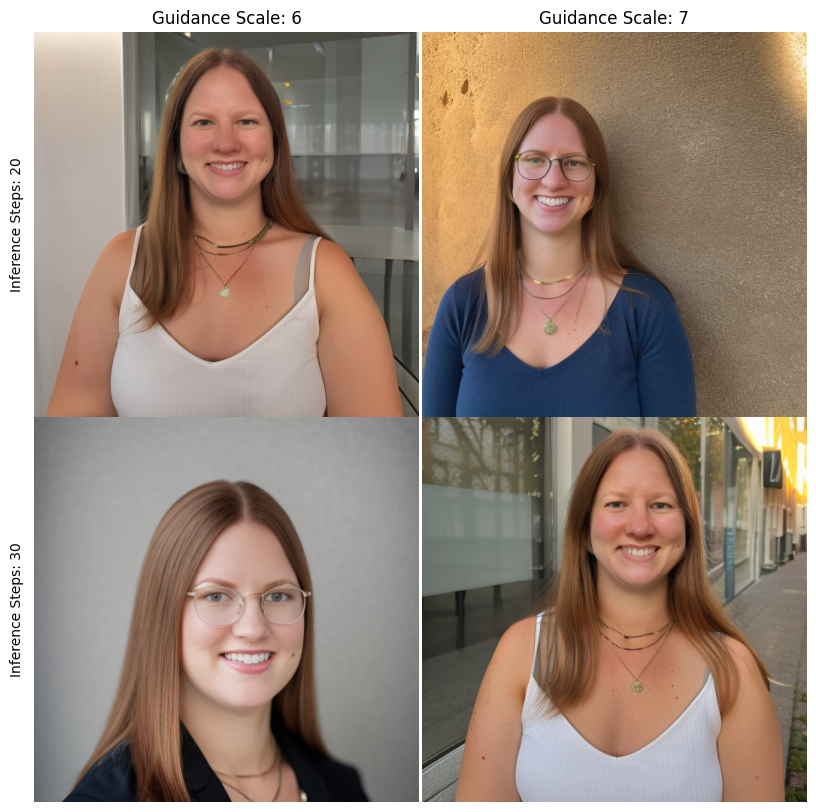

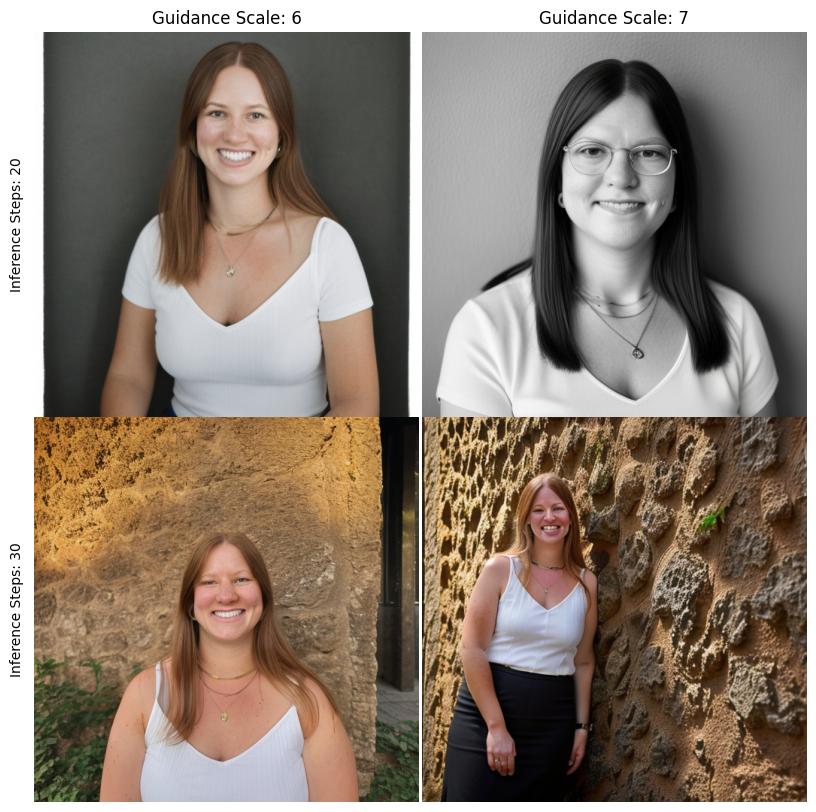

In [ ]:
plots = []
for output in pipe_outputs:
  fig, axs = create_image_grid(output, columns=grid_cols,rows=grid_rows, labels_x=labels_x, labels_y=labels_y)
  plt.subplots_adjust(hspace=0, wspace=0)
  plots.append(fig)
  plt.show()

In [ ]:
def get_inputs(batch_size=1):
    generator = [torch.Generator("cuda").manual_seed(i) for i in range(batch_size)]
    prompts = batch_size * [prompt]
    num_inference_steps = 30
    guidance_scale=7

    return {"prompt": prompts, "generator": generator, "num_inference_steps": num_inference_steps, "guidance_scale": guidance_scale}

In [ ]:
prompt = "business headshot of a ohwx woman, business clothing"

  0%|          | 0/30 [00:00<?, ?it/s]

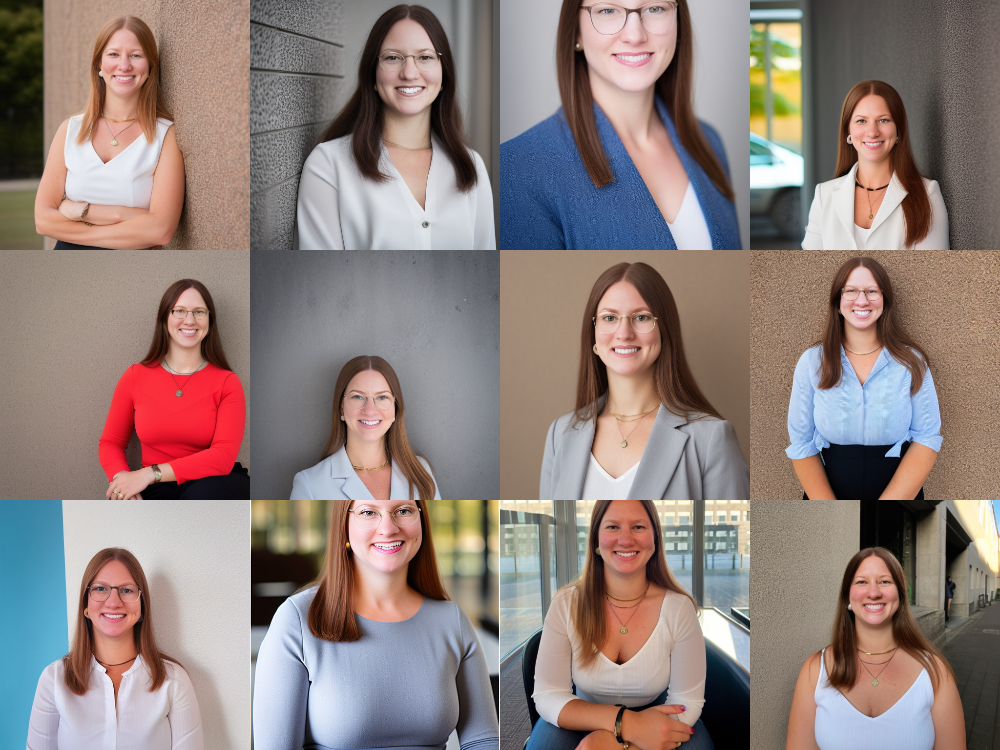

In [ ]:
images = pipes[1](**get_inputs(batch_size=12)).images
make_image_grid(images, rows=3, cols=4)

## Save SD 1.5 Inference Grid Photos

In [ ]:
save_dir= "/content/drive/MyDrive/dreambooth/C00_001"

### Single Image Download

In [ ]:
def save_image_set(image_set, save_dir, set_name):
  """Saves an image set to a specified directory.

  Args:
    image_set: A list of images to save.
    output_dir: The root directory where the set will be saved.
    set_name: The name of the subdirectory for the set.
  """

  # Create the subdirectory for the set
  set_dir = os.path.join(save_dir, set_name)
  os.makedirs(set_dir, exist_ok=True)

  # Save each image in the set
  for i, image in enumerate(image_set):
    image_path = os.path.join(set_dir, f'image_{i}.jpg')  # Adjust file format as needed
    image.save(image_path)

In [ ]:
for i, output in enumerate(pipe_outputs):
    save_image_set(output, save_dir, f"inference_grid_single_images_{i:03d}")

### Save and Download Inference Grid Image

In [ ]:
counter =0
for plot in plots:
  counter= counter+1
  filepath = os.path.join(save_dir, f"Inference_Grid_{counter}")
  plot.savefig(filepath)

## Inference (SDXL) = LoRA Inference (da SDXL Dreambooth nur mit LoRa möglich)

In [ ]:
model_path ="dreambooth/C00_001/sdxl_001"

In [ ]:
pipeline = StableDiffusionXLPipeline.from_pretrained(
    model_path, torch_dtype=torch.float16, variant="fp16", use_safetensors=True, safety_checker= None
).to("cuda")

OSError: Error no file named model_index.json found in directory dreambooth/stachel_sdxl1.

In [ ]:
pipeline.scheduler = DDIMScheduler.from_config(pipeline.scheduler.config)
pipeline.enable_attention_slicing()

In [ ]:
prompt = "business headshot of a C00_001 man"
neg_prompt = "(((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquidtongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missingbreasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fusedears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears, old photo, low res, black and white, black and white filter, colorless, (((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquid tongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missing breasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fused ears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears, old photo, low res, black and white, black and white filter, colorless, (((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquid tongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missing breasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fused ears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears, (((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquidtongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missingbreasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fusedears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears,"

In [ ]:
def get_inputs(batch_size=1):
    generator = [torch.Generator("cuda").manual_seed(i) for i in range(batch_size)]
    prompts = batch_size * [prompt]
    num_inference_steps = 20
    guidance_scale=7.5

    return {"prompt": prompts, "generator": generator, "num_inference_steps": num_inference_steps, "guidance_scale": guidance_scale}

In [ ]:
prompt += "frontal shot, serious look, business clothing, black suit"
prompt += "50mm portrait photography, 8k, high definition, grey background"

In [ ]:
images = pipeline(**get_inputs(batch_size=8)).images
make_image_grid(images, rows=2, cols=4)

### perhaps remove

In [ ]:
# all_images = []

# for _ in range(num_rows):
#     # images = pipeline(prompt, num_images_per_prompt=num_samples_per_row, num_inference_steps=100, guidance_scale=7.5).images
#     images = pipeline(prompt=prompt, num_images_per_prompt=num_samples_per_row, num_inference_steps=50, guidance_scale=7.5).images
#     all_images.extend(images)


# # Save all images individually
# for i, image in enumerate(all_images):
#     image.save(f"image_{i}.png")

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

In [ ]:
# image = pipeline(prompt, generator=generator, num_inference_steps=20, guidance_scale=7.5).images[0]
# image

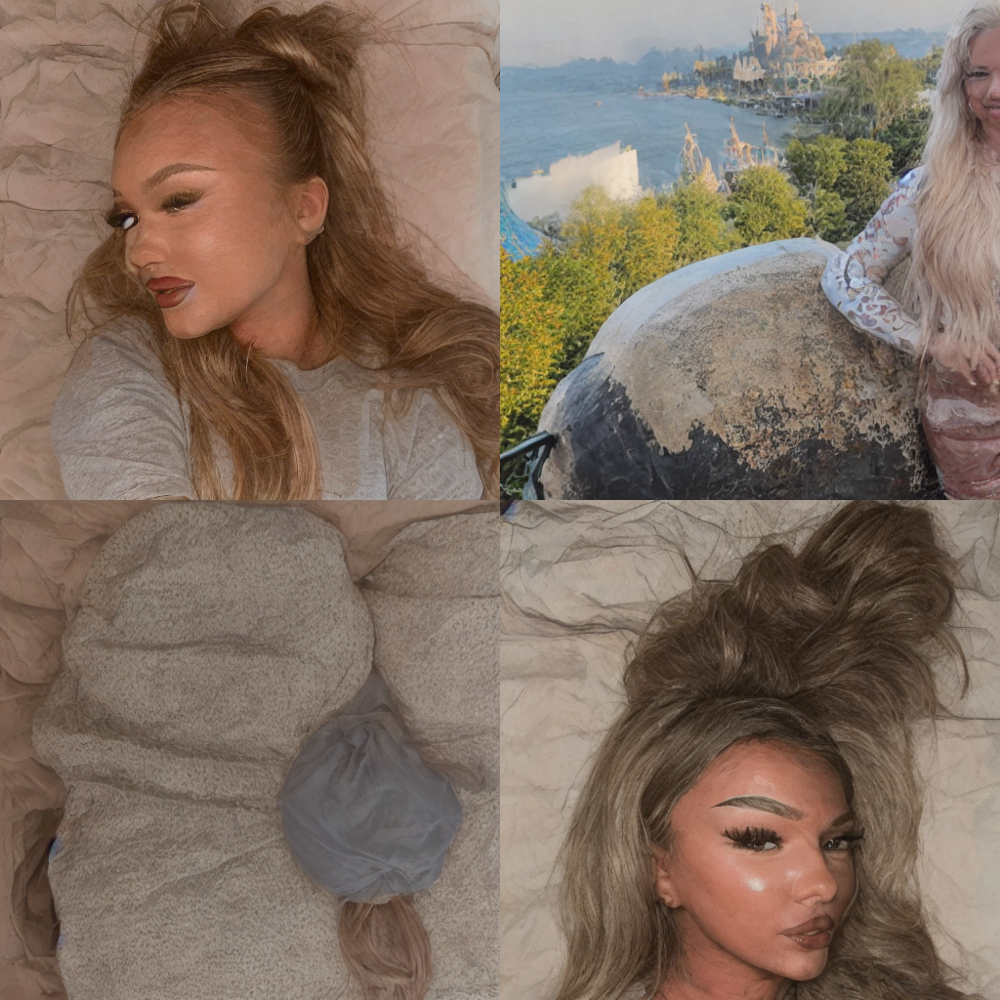

In [ ]:
# num_samples_per_row = 2
# num_rows = 2
# prompt = "photo of a s10412sqwwe woman"
# prompt_2 ="RAW photo, d01dli1wweieda, 8k uhd, dslr, soft lighting, high quality, Fujifilm XT3"
# grid = make_image_grid(all_images, num_rows, num_samples_per_row)
# grid

In [ ]:
model_path ="/content/dreambooth/stachel2"

In [ ]:
pipeline_text2image = DiffusionPipeline.from_pretrained(
    model_path, torch_dtype=torch.float16, variant="fp16", use_safetensors=True, safety_checker= None
).to("cuda")

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


In [ ]:
num_samples_per_row = 2
num_rows = 2
prompt = "photo of a s10412sqwwe woman in business clothing"

In [ ]:
all_images = []

for _ in range(num_rows):
    # images = pipeline(prompt, num_images_per_prompt=num_samples_per_row, num_inference_steps=100, guidance_scale=7.5).images
    images = pipeline_text2image(prompt=prompt, num_images_per_prompt=num_samples_per_row, num_inference_steps=100, guidance_scale=3.5).images
    all_images.extend(images)


# Save all images individually
for i, image in enumerate(all_images):
    image.save(f"image_{i}.png")

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

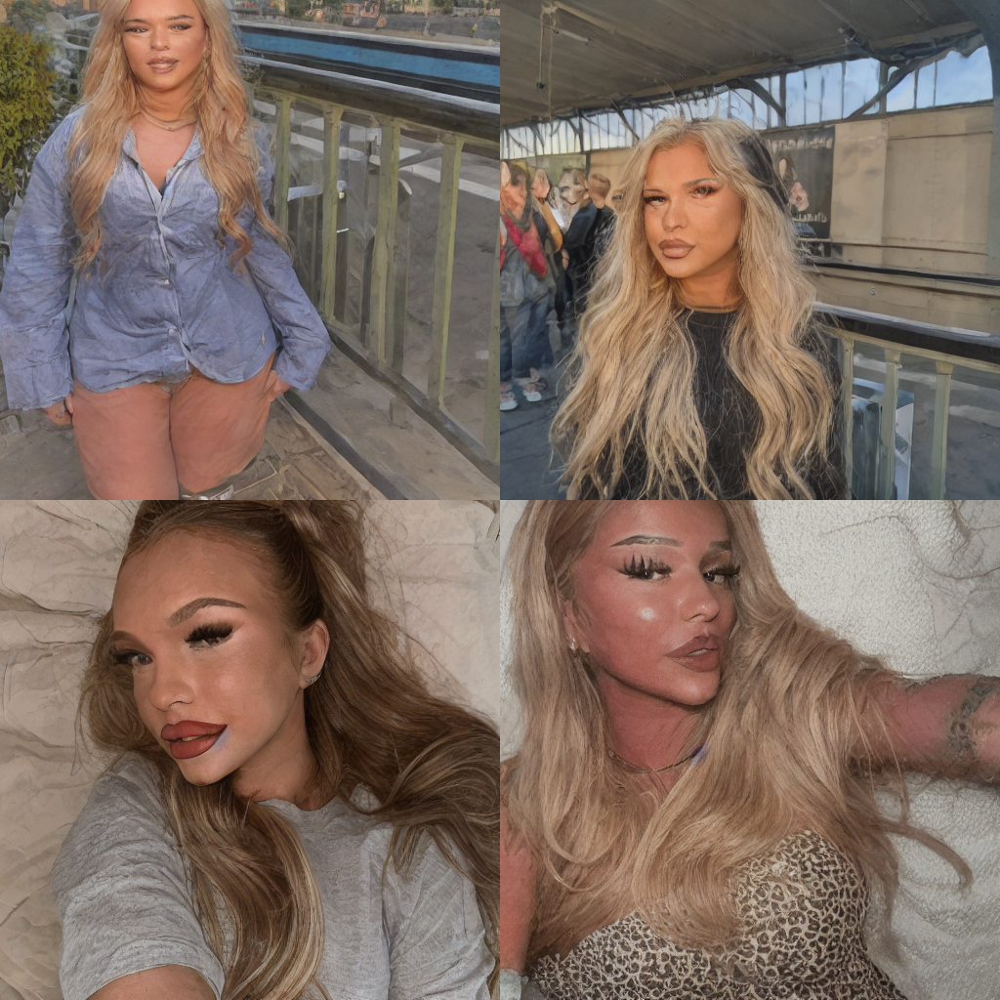

In [ ]:
grid = make_image_grid(all_images, num_rows, num_samples_per_row)
grid

## Inference Grid (SDXL)

In [ ]:
model_path ="dreambooth/C00_001/sdxl_001"

In [ ]:
!nvidia-smi

In [ ]:
total_pipes = 2
pipes = []
schedulers = [DDIMScheduler, DDPMScheduler, DPMSolverMultistepScheduler]

In [ ]:
for i in range(total_pipes):
  pipe = StableDiffusionPipeline.from_pretrained(
    model_path, torch_dtype=torch.float16, use_safetensors=True, safety_checker=None,
  ).to("cuda")

  pipe.enable_attention_slicing()
  pipe.scheduler = schedulers[i].from_config(pipe.scheduler.config)

  if pipe.scheduler == DPMSolverMultistepScheduler:
    pipe.scheduler.use_karras_sigmas = True

  pipes.append(pipe)

In [ ]:
prompt = "business headshot of a handsome C00_001 man, professional clothing, serious face, open eyes"
neg_prompt = "(((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquidtongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missingbreasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fusedears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears, old photo, low res, black and white, black and white filter, colorless, (((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquid tongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missing breasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fused ears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears, old photo, low res, black and white, black and white filter, colorless, (((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquid tongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missing breasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fused ears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears, (((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquidtongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missingbreasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fusedears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears,"

In [ ]:
inf_start= 30
scale_start=4
max_inf_steps=80
max_scale=9
inf_step_increase=10
scale_increase=1

In [ ]:
grid_rows=int(max_scale-scale_start)
grid_cols=int((max_inf_steps-inf_start)/inf_step_increase)

In [ ]:
print(grid_rows)
print(grid_cols)

In [ ]:
def create_parameter_list(prompt, neg_prompt):
    """Creates a list of dictionaries containing the parameters.

    Args:
        prompt: The prompt for the model.
        neg_prompt: The negative prompt for the model.

    Returns:
        A list of dictionaries containing the parameters.
    """

    parameters = []
    for num_inference_steps in range(inf_start, max_inf_steps, inf_step_increase):
        for guidance_scale in range(scale_start, max_scale, scale_increase):
            parameters.append({
                "prompt": prompt,
                "neg_prompt": neg_prompt,
                "num_inference_steps": num_inference_steps,
                "guidance_scale": guidance_scale
            })
    return parameters

parameter_list = create_parameter_list(prompt, neg_prompt)

In [ ]:
def create_image_grid(images, columns, rows, figsize=(10,10),labels_x=None, labels_y=None):
    """
    Creates a grid of images using matplotlib and numpy.

    Args:
        images: A list of image data.
        columns: The number of columns in the grid.
        rows: The number of rows in the grid.
        labels_x: A list of labels for the x-axis (columns).
        labels_y: A list of labels for the y-axis (rows).

    Returns:
        The figure and axes objects.
    """

    fig, axs = plt.subplots(rows, columns, figsize=(10, 10))  # Adjust figure size as needed

    for i in range(rows):
        for j in range(columns):
            index = i * columns + j
            if index < len(images):
                axs[i, j].imshow(images[index])
                axs[i, j].tick_params(axis='both', length=0, width=0)
                axs[i, j].set_xticklabels([])
                axs[i, j].set_yticklabels([])
                axs[i, j].spines['top'].set_visible(False)
                axs[i, j].spines['right'].set_visible(False)
                axs[i, j].spines['bottom'].set_visible(False)
                axs[i, j].spines['left'].set_visible(False)

    # Add column labels
    if labels_x:
        for i in range(columns):
            axs[0, i].set_title(labels_x[i])

    # Add row labels
    if labels_y:
        for i in range(rows):
            axs[i, 0].set_ylabel(labels_y[i])

    return fig, axs

In [ ]:
inference_steps_list = my_list = list(OrderedDict.fromkeys([param["num_inference_steps"] for param in parameter_list]).keys())
guidance_scale_list = my_list = list(OrderedDict.fromkeys([param["guidance_scale"] for param in parameter_list]).keys())
labels_x = [f"Guidance Scale: {step}" for step in guidance_scale_list]
labels_y = [f"Inference Steps: {step}" for step in inference_steps_list]

In [ ]:
%%capture

pipe_outputs = []
for pipe in pipes:
    pipe.enable_vae_slicing()
    pipe.enable_model_cpu_offload()
    images = []
    for line in parameter_list:
        images.extend(pipe(prompt=prompt, neg_prompt=neg_prompt, num_inference_steps=line["num_inference_steps"], guidance_scale=line["guidance_scale"]).images)
    pipe_outputs.append(images)

In [ ]:
plots = []
for output in pipe_outputs:
  fig, axs = create_image_grid(output, columns=grid_cols,rows=grid_rows, labels_x=labels_x, labels_y=labels_y)
  plt.subplots_adjust(hspace=0, wspace=0)
  plots.append(fig)
  plt.show()

## Save SD XL Inference Grid Photos

In [ ]:
save_dir= "/content/drive/MyDrive/dreambooth/C00_001/sdxl_001"

### Single Image Download

In [ ]:
import os
from google.colab import drive

def save_image_set(image_set, save_dir, set_name):
  """Saves an image set to a specified directory.

  Args:
    image_set: A list of images to save.
    output_dir: The root directory where the set will be saved.
    set_name: The name of the subdirectory for the set.
  """

  # Create the subdirectory for the set
  set_dir = os.path.join(save_dir, set_name)
  os.makedirs(set_dir, exist_ok=True)

  # Save each image in the set
  for i, image in enumerate(image_set):
    image_path = os.path.join(set_dir, f'image_{i}.jpg')  # Adjust file format as needed
    image.save(image_path)

In [ ]:
for i, output in enumerate(pipe_outputs):
    save_image_set(output, save_dir, f"inference_grid_single_images_{i:03d}")

### Save and Download Inference Grid Image

In [ ]:
counter =0
for plot in plots:
  counter= counter+1
  filepath = os.path.join(save_dir, f"Inference_Grid_{counter}")
  plot.savefig(filepath)

## Inference (Checkpoint)

In [ ]:
!echo $OUTPUT_DIR
helper = os.environ['OUTPUT_DIR']
print(helper)

KeyError: 'OUTPUT_DIR'

In [ ]:
from diffusers import DiffusionPipeline, UNet2DConditionModel
from transformers import CLIPTextModel
import torch
# model_path ="dreambooth/patrick"
from diffusers import AutoencoderKL


In [ ]:

unet = UNet2DConditionModel.from_pretrained("/content/drive/My Drive/results/archive/sd15_dbooth_hannah_3/checkpoint-1200/unet", torch_dtype=torch.float16)
vae = AutoencoderKL.from_pretrained("stabilityai/sd-vae-ft-mse", torch_dtype=torch.float16).to("cuda")
# if you have trained with `--args.train_text_encoder` make sure to also load the text encoder
# text_encoder = CLIPTextModel.from_pretrained("/content/dreambooth/patrick/checkpoint-500/text_encoder")

pipeline = DiffusionPipeline.from_pretrained(
    "benjamin-paine/stable-diffusion-v1-5", vae=vae, unet=unet,
).to("cuda")

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/clip/feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(


In [ ]:
from diffusers import DDIMScheduler, DDPMScheduler, DPMSolverMultistepScheduler
# from diffusers import DPMSolverMultistepScheduler

pipeline.scheduler = DDPMScheduler.from_config(pipeline.scheduler.config)
# pipeline.scheduler.use_karras_sigmas = True

# pipeline2.scheduler = DDPMScheduler.from_config(pipeline.scheduler.config)

In [ ]:
pipeline.enable_attention_slicing()

In [ ]:
pipeline = pipeline.to(torch.float16)


In [ ]:
# pipeline.scheduler.compatibles

In [ ]:
prompt = "business headshot of a ohwx woman, neutral grey background, corporate portrait"

In [ ]:
# prompt = "business headshot of a ohwx woman, neutral grey background, frontal portrait, 8k HD, realistic, upper body"

In [ ]:
# negative_prompt="wide figure, high weight, fat, bad anatomy, poor facial details, deformed teeth, deformed eyes,"

In [ ]:
# negative_prompt = "poorly Rendered face, poorly drawn face, poor facial details ,poorly drawn hands ,poorly rendered hands ,low resolution ,bad composition ,mutated body parts ,blurry image ,disfigured ,oversaturated, bad anatomy, deformed body features"

In [ ]:
prompt=   "business headshot of a ohwx woman, neutral grey background, corporate portrait"

prompts = [
  "business headshot of a ohwx woman, neutral grey background, corporate portrait",
  "business headshot of a ohwx woman, neutral grey background, corporate portrait",
  "business headshot of a ohwx woman, neutral grey background, corporate portrait",
  "business headshot of a ohwx woman, neutral grey background, corporate portrait",
 ]
generators = [torch.Generator("cuda").manual_seed(1) for _ in range(len(prompts))]

images = pipeline(prompt=prompts, generator=generators, num_inference_steps=20, guidance_scale=7).images
# make_image_grid(images, 2, 2)
# make_image_grid(helper, 2, 2)

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

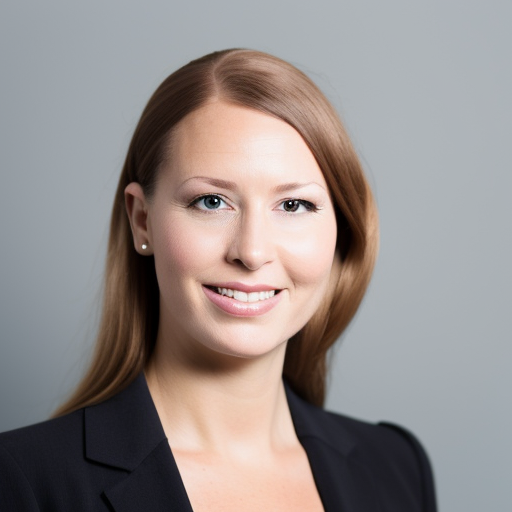

In [ ]:
# image = pipeline(prompt,negative_prompt=negative_prompt, num_inference_steps=25, guidance_scale=9, safety_checker=False).images[0]
images = pipeline(prompt, num_inference_steps=50, guidance_scale=10, safety_checker=False).images[0]
images


  0%|          | 0/50 [00:00<?, ?it/s]

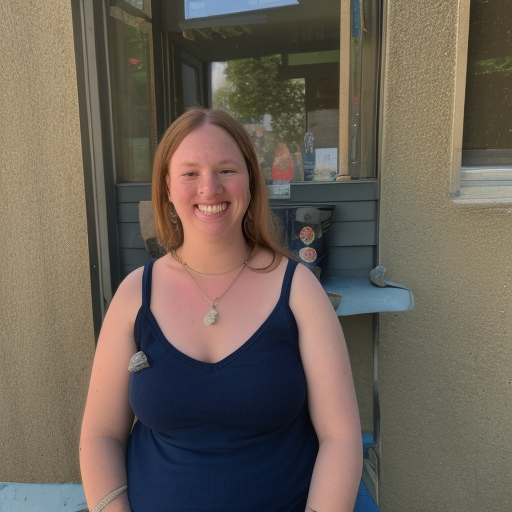

In [ ]:
images = pipeline(prompt="photo of a ohwx woman", num_inference_steps=50, guidance_scale=5).images[0]
images

StableDiffusionPipelineOutput(images=[<PIL.Image.Image image mode=RGB size=512x512 at 0x7E589D9F1420>], nsfw_content_detected=[False])

In [ ]:
def get_inputs(batch_size=1):
    # generator = [torch.Generator("cuda").manual_seed(i) for i in range(batch_size)]
    prompts = batch_size * [prompt]
    num_inference_steps = 25
    guidance_scale=9

    return {"prompt": prompts, "neg_prompt": neg_prompt, "num_inference_steps": num_inference_steps, "guidance_scale": guidance_scale}

In [ ]:
# prompt += "frontal shot, serious look, business clothing"
# prompt += "50mm portrait photography, 8k, high definition, blue background"

In [ ]:
from diffusers.utils import make_image_grid
images = pipeline(**get_inputs(batch_size=8)).images
make_image_grid(images, rows=2, cols=4)

  0%|          | 0/25 [00:00<?, ?it/s]

RuntimeError: Input type (float) and bias type (c10::Half) should be the same

In [ ]:
del pipeline.vae
del pipeline.unet
del pipeline.scheduler
del pipeline
del images

In [ ]:
del generators

In [ ]:
prep_utils.memory_stats()

1827.1728515625
7436.0


In [ ]:
import gc
gc.collect()

288

In [ ]:
for i, image in enumerate(images):
    image.save(f"image_{i}.png")

## Lora inference

In [ ]:
from diffusers import AutoPipelineForText2Image
import torch
model_path ="dreambooth/stachel_sdxl1"

pipeline_lora = AutoPipelineForText2Image.from_pretrained("stabilityai/stable-diffusion-xl-base-1.0", torch_dtype=torch.float16).to("cuda")
pipeline_lora.load_lora_weights(model_path, weight_name="pytorch_lora_weights.safetensors")


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [ ]:
image = pipeline_lora("photo of s10412sqwwe woman").images[0]
image

# Save model

In [ ]:
shutil.make_archive('patrick_dreambooth_100', 'zip', base_dir='dreambooth/patrick/checkpoint-1000')


'patrick_dreambooth_100.zip'

In [ ]:
shutil.make_archive('patrick_dreambooth_500', 'zip', base_dir='dreambooth/patrick/checkpoint-500')

'patrick_dreambooth_500.zip'